# Tech usage behavioral survey analysis

In this notebook, I'll be using numpy / scipy to analyze the social cybersecurity behavioral surveys from 2014-15. I've outlined the rough story in [this Google doc](https://docs.google.com/document/d/1fWIRK3KClbN_YP4enOhUnmkQ70DfBcuWaIAk1qwieYM/edit#heading=h.uyr4owo53v0n)

I'm using this both as a means of analysis and as a means of deliberate practice.

First, gotta import the goods: numpy, scipy, pandas and ggplot to start

In [1]:
import numpy as np
import scipy
import pandas as pd
from ggplot import *
import altair as alt

/Users/chimps/anaconda3/lib/python3.6/site-packages/ggplot/utils.py:81: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  pd.tslib.Timestamp,
/Users/chimps/anaconda3/lib/python3.6/site-packages/ggplot/stats/smoothers.py:4: FutureWarning: The pandas.lib module is deprecated and will be removed in a future version. These are private functions and can be accessed from pandas._libs.lib instead
  from pandas.lib import Timestamp
/Users/chimps/anaconda3/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


Next, have to impoirt the data into a pandas dataframe so that it's more familiar to R, which I should be using anyway.

In [5]:
# raw_data = np.genfromtxt('./tech_usage_subset_2.csv', delimiter=',', dtype=None, names=True)
raw_data = pd.read_csv('./tech_usage_subset_4.csv')
raw_data = raw_data.drop(['ResponseID'], axis=1).dropna(axis=1, how='all')
raw_data = raw_data.drop(raw_data.index[743])
print(raw_data.shape)
rd_dtypes = raw_data.columns.to_series().groupby(raw_data.dtypes).groups
print(rd_dtypes)
# print("colnames: ", list(raw_data))
# print(raw_data.head(5))
# print(raw_data.loc[0:5, ['ResponseID', 'PhoneType']])

(852, 365)
{dtype('int64'): Index(['Age', 'NumAdults'], dtype='object'), dtype('O'): Index(['PhoneType', 'ChangedMobileAuth', 'ChangedSNSPrivacy', 'UninstalledApp',
       'ChangedPassword', 'RecentChangeOpenEnded',
       'UnlistedChange-StrangerBreach', 'UnlistedChange-KnownBreach',
       'UnlistedChange-ShareAccess', 'UnlistedChange-ObservedOthers',
       ...
       'Occupation', 'Occuptation-Other', 'Nationality', 'NativeEnglish',
       'Hispanic/Latino', 'Ethnicity-Native', 'Ethnicity-Asian',
       'Ethnicity-Black', 'Ethnicity-PacificIslande', 'Ethnicity-White'],
      dtype='object', length=363)}


Alright, let's get some basic descriptive stats here, shall we?

In [6]:
def numeric_description(x):
    means = x.select_dtypes(include=['number']).apply(np.nanmean)
    sds = x.select_dtypes(include=['number']).apply(np.nanstd)
    mx = x.select_dtypes(include=['number']).apply(np.amax)
    mn = x.select_dtypes(include=['number']).apply(np.amin)
    return pd.DataFrame([means, sds, mx, mn], index=['Mean', 'SD', 'Max', 'Min'])

vals = numeric_description(raw_data)
print(vals)

            Age  NumAdults
Mean  32.572770   2.498826
SD    10.002141   1.690556
Max   74.000000  28.000000
Min   18.000000   0.000000


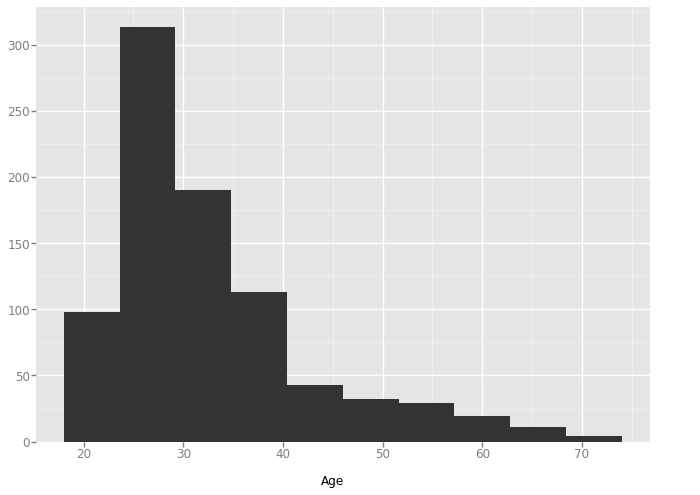

<ggplot: (-9223372029316325323)>

In [7]:
ggplot(aes(x='Age'), data=raw_data) + geom_histogram()

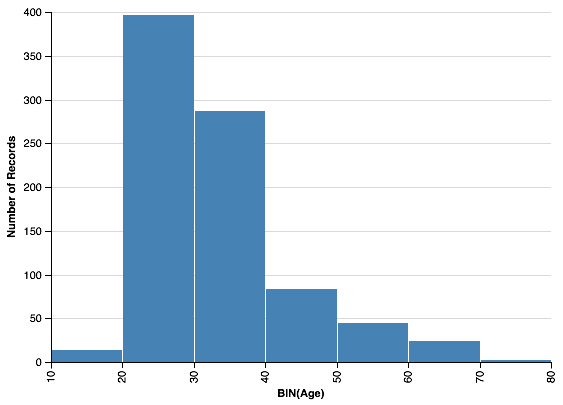

In [8]:
alt.Chart(raw_data).mark_bar().encode(
    alt.X("Age", bin=True),
    y='count(*):Q'
)

In [9]:
gender_counts = raw_data['Gender'].value_counts()
gender_rates = gender_counts / raw_data.shape[0]
print(gender_counts)
print("")
print(gender_rates)

Male                    537
Female                  312
Prefer not to answer      2
Non-conforming            1
Name: Gender, dtype: int64

Male                    0.630282
Female                  0.366197
Prefer not to answer    0.002347
Non-conforming          0.001174
Name: Gender, dtype: float64


In [10]:
ethnicity_cols = ['Ethnicity-Native', 'Ethnicity-Asian', 'Ethnicity-Black', 'Ethnicity-PacificIslande', 'Ethnicity-White']
print([raw_data[c].value_counts() for c in ethnicity_cols])

[American Indian or Alaska Native    18
Name: Ethnicity-Native, dtype: int64, Asian    369
Name: Ethnicity-Asian, dtype: int64, Black or African American    37
Name: Ethnicity-Black, dtype: int64, Native Hawaiian or other Pacific Islander    7
Name: Ethnicity-PacificIslande, dtype: int64, White    428
Name: Ethnicity-White, dtype: int64]


In [11]:
def print_counts(cols):
    for col in cols:
        counts = raw_data[col].value_counts()
        rates = counts / raw_data.shape[0]
        print(col)
        print(pd.DataFrame({'count': counts, 'rate': rates}))
        print("")

def print_series_counts(series):
    counts = series.value_counts()
    rates = counts / series.size
    print(pd.DataFrame({'count': counts, 'rate': rates}))
    print("")
        
other_demographic_cols = ['RelationshipStatus', 'ParentUnder18', 'HighestDegree', 'Occupation', 'Nationality', 'NativeEnglish', 'Hispanic/Latino']
print_counts(other_demographic_cols)

RelationshipStatus
                             count      rate
Currently married              343  0.402582
Currently single               312  0.366197
Currently in a relationship    187  0.219484
Prefer not to answer            10  0.011737

ParentUnder18
     count     rate
No     585  0.68662
Yes    267  0.31338

HighestDegree
                                     count      rate
Bachelor's degree                      401  0.470657
Post-graduate degree                   160  0.187793
Some college; no degree                145  0.170188
Graduated high school or equivalent     75  0.088028
Associate degree                        65  0.076291
12th grade or less                       6  0.007042

Occupation
                                         count      rate
Other                                      362  0.424883
Computer Science related                   223  0.261737
Other engineering or technology related    175  0.205399
Cybersecurity related                       10  0.01173

Okay, so that's the descriptive demographics. How about descriptive behavioral data?

In [12]:
sebis_cols = [
    'SEBIS-AutoLock',
    'SEBIS-LaptopAuth',
    'SEBIS-ManualLock',
    'SEBIS-MobileAuth',
    'SEBIS-ChangePasswords',
    'SEBIS-DiffPasswords',
    'SEBIS-NewPasswords',
    'SEBIS-SpecialCharPasswords',
    'SEBIS-LinkVerify',
    'SEBIS-AestheticVerify',
    'SEBIS-HTTPSVerify',
    'SEBIS-LinkMouseover',
    'SEBIS-ReportSecurity',
    'SEBIS-ImmediateUpdate',
    'SEBIS-UpdatedSoftware',
    'SEBIS-AVAutoUpdates'
]

sebis_scale_conversion = {
    'Never (1)': int(1),
    'Rarely (2)': int(2),
    'Sometimes (3)': int(3),
    'Often (4)': int(4),
    'Always (5)': int(5)
}

def convert_sebis_cols_to_int(cols=sebis_cols):
    for col in cols:
        raw_data[col] = raw_data[col].map(sebis_scale_conversion).dropna().astype(int)

convert_sebis_cols_to_int()
# print(pd.isnull(raw_data[sebis_cols]).any(1).nonzero()[0])

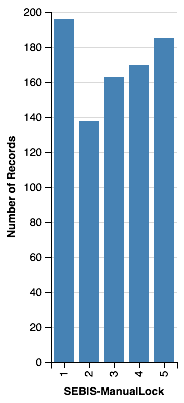

In [13]:
seb_ml = alt.Chart(raw_data).mark_bar().encode(
    alt.X("SEBIS-ManualLock:O"),
    y="count(*):Q"
)

seb_ma = alt.Chart(raw_data).mark_bar().encode(
    alt.X("SEBIS-MobileAuth:O"),
    y="count(*):Q"
)

seb_ml

In [14]:
sebis_vals = pd.melt(raw_data[sebis_cols])

print("SEBIS distributions")
print(sebis_vals.groupby('variable').agg([lambda x: tuple(np.percentile(x, [0,25,50,75,100]))]))

SEBIS distributions
                                                 value
                                              <lambda>
variable                                              
SEBIS-AVAutoUpdates          (1.0, 3.0, 4.0, 5.0, 5.0)
SEBIS-AestheticVerify       (1.0, 2.0, 3.0, 3.25, 5.0)
SEBIS-AutoLock               (1.0, 2.0, 4.0, 5.0, 5.0)
SEBIS-ChangePasswords        (1.0, 2.0, 3.0, 4.0, 5.0)
SEBIS-DiffPasswords          (1.0, 3.0, 4.0, 5.0, 5.0)
SEBIS-HTTPSVerify            (1.0, 1.0, 2.0, 3.0, 5.0)
SEBIS-ImmediateUpdate        (1.0, 2.0, 3.0, 4.0, 5.0)
SEBIS-LaptopAuth             (1.0, 3.0, 5.0, 5.0, 5.0)
SEBIS-LinkMouseover          (1.0, 3.0, 4.0, 4.0, 5.0)
SEBIS-LinkVerify             (1.0, 1.0, 2.0, 3.0, 5.0)
SEBIS-ManualLock             (1.0, 2.0, 3.0, 4.0, 5.0)
SEBIS-MobileAuth             (1.0, 2.0, 4.0, 5.0, 5.0)
SEBIS-NewPasswords           (1.0, 3.0, 4.0, 4.0, 5.0)
SEBIS-ReportSecurity         (1.0, 1.0, 2.0, 3.0, 5.0)
SEBIS-SpecialCharPasswords   (1.0, 1.0, 2.0, 

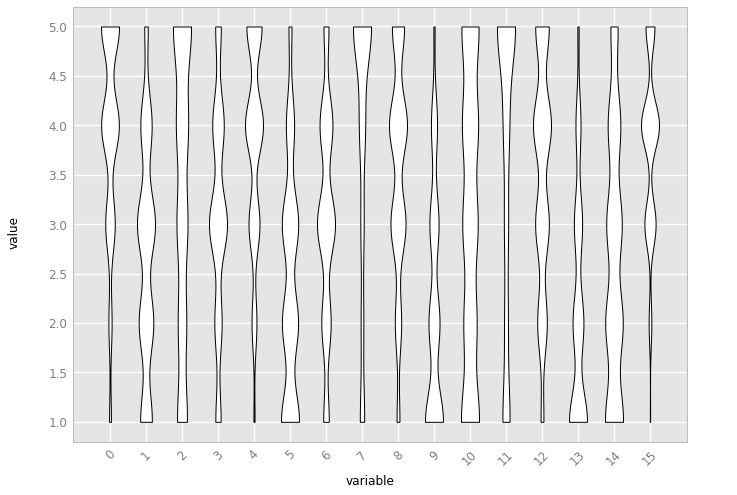

<ggplot: (7537842787)>

In [15]:
sebis_label_map = {
    'SEBIS-AutoLock': 'Auto Lock',
    'SEBIS-LaptopAuth': 'Laptop Auth',
    'SEBIS-ManualLock': 'Manual Lock',
    'SEBIS-MobileAuth': 'Mobile Auth',
    'SEBIS-ChangePasswords': 'Change Passwords',
    'SEBIS-DiffPasswords': 'Diff Passwords',
    'SEBIS-NewPasswords': 'New Passwords',
    'SEBIS-SpecialCharPasswords': 'Special Char Passwords',
    'SEBIS-LinkVerify': 'Link Verify',
    'SEBIS-AestheticVerify': 'Aesthetic Verify',
    'SEBIS-HTTPSVerify': 'HTTPS Verify',
    'SEBIS-LinkMouseover': 'Link Mouseover',
    'SEBIS-ReportSecurity': 'Report Security',
    'SEBIS-ImmediateUpdate': 'Immediate Update',
    'SEBIS-UpdatedSoftware': 'Updated Sofwtare',
    'SEBIS-AVAutoUpdates': 'AV Auto Update'
}
sebis_vals['variable'] = sebis_vals['variable'].map(sebis_label_map)
ggplot(aes(x='variable', y='value'), data=sebis_vals) +\
    geom_violin() + theme(axis_text_x = element_text(angle=45))

## Visualization still a bit of a mess but going to move on to actual analysis...

First, need to separate out those who did one of the behavior changes vs those who did not.

In [16]:
behavior_cols = ['ChangedMobileAuth', 'ChangedSNSPrivacy', 'UninstalledApp',
       'ChangedPassword']

behavior_options = {
    "Yes I've done this in the past 6 months": 1,
    "No I haven't done this in the past 6 months": 2,
    "No I've never done this": 3,
    "I don't remember": 17
}

print_counts(behavior_cols)

print_counts(['RecentChangeOpenEnded'])

ChangedMobileAuth
                                             count      rate
Yes I've done this in the past 6 months        454  0.532864
No I haven't done this in the past 6 months    195  0.228873
No I've never done this                        186  0.218310
I don't remember                                17  0.019953

ChangedSNSPrivacy
                                             count      rate
Yes I've done this in the past 6 months        427  0.501174
No I haven't done this in the past 6 months    245  0.287559
No I've never done this                        169  0.198357
I don't remember                                11  0.012911

UninstalledApp
                                             count      rate
Yes I've done this in the past 6 months        378  0.443662
No I've never done this                        240  0.281690
No I haven't done this in the past 6 months    207  0.242958
I don't remember                                27  0.031690

ChangedPassword
               

In [17]:
# Next, going to try to find out percetage of people who did at least one thing in the past 6 months.
DID_BEHAVIOR_OPT = "Yes I've done this in the past 6 months"

def pick_any_yes(row):
    return np.any(row == DID_BEHAVIOR_OPT)

any_behavior = raw_data[behavior_cols].apply(pick_any_yes, 1)
raw_data['did_any'] = any_behavior

print_counts(['did_any'])

did_any
       count      rate
True     807  0.947183
False     45  0.052817



In [18]:
def _xtract_behavior_subset(behavior_col):
    return raw_data.loc[raw_data[behavior_col] == "Yes I've done this in the past 6 months"]

def extract_behavior_subsets(cols=behavior_cols):
    retval = {}
    for col in behavior_cols:
        retval[col] = _xtract_behavior_subset(col)
    return retval

behavior_subsets = extract_behavior_subsets()
print([x.shape for x in behavior_subsets.values()])

[(454, 366), (427, 366), (378, 366), (688, 366)]


In [19]:
# Start conducting trigger analysis per behavior
print(list(raw_data))
trigger_suffixes = [
    'StrangerBreach',
    'KnownBreach',
    'ShareAccess',
    'ObservedOthers'
    'ReceivedAdvice',
    'DevicePrompt',
    'OrgRequired',
    'ReadNews',
    'BrowsedSetting',
    'OtherTrigger',
    'NoTrigger',
    'OtherTrigger2'
]

print(raw_data['ChangedPwd-ObservedByOther2'].value_counts())

['PhoneType', 'ChangedMobileAuth', 'ChangedSNSPrivacy', 'UninstalledApp', 'ChangedPassword', 'RecentChangeOpenEnded', 'UnlistedChange-StrangerBreach', 'UnlistedChange-KnownBreach', 'UnlistedChange-ShareAccess', 'UnlistedChange-ObservedOthers', 'UnlistedChange-ReceivedAdvice', 'UnlistedChange-DevicePrompt', 'UnlistedChange-OrgRequired', 'UnlistedChange-ReadNews', 'UnlistedChange-BrowsedSetting', 'UnlistedChange-OtherTrigger', 'UnlistedChange-NoTrigger', 'UnlistedChange-OtherTrigger2', 'UnlistedChange-FriendBreached', 'UnlistedChange-FamilyBreached', 'UnlistedChange-SOBreached', 'UnlistedChange-ColleagueBreached', 'UnlistedChange-SharedWithFriend', 'UnlistedChange-SharedWithFamily', 'UnlistedChange-SharedWithSO', 'UnlistedChange-SharedWithColleague', 'UnlistedChange-ObservedFriend', 'UnlistedChange-ObservedFamily', 'UnlistedChange-ObservedSO', 'UnlistedChange-ObservedColleague', 'UnlistedChange-AdvisedByFriend', 'UnlistedChange-AdvisedByFamily', 'UnlistedChange-AdvisedBySO', 'UnlistedCha

In [20]:
prefix_to_behavior_map = {
    'MobileAuth': 'ChangedMobileAuth',
    'SNSPrivacyChange': 'ChangedSNSPrivacy',
    'AppUninstall': 'UninstalledApp',
    'ChangedPwd': 'ChangedPassword'
}

behavior_prefices = [
    'MobileAuth',
    # 'UnlistedChange',
    'SNSPrivacyChange',
    'AppUninstall',
    'ChangedPwd'
]

trigger_suffices = [
    'StrangerBreach',
    'KnownBreach',
    'ShareAccess',
    'ObservedOthers',
    'ReceivedAdvice',
    'DevicePrompt',
    'OrgRequired',
    'ReadNews',
    'BrowsedSetting',
    'NoTrigger',
    'OtherTriggerClassified'
]

exclusions = {
    'AppUninstall': ['ShareAccess', 'BrowsedSetting']
}

inclusions = {
    'AppUninstall': []
}

def trigger_analysis(behavior_prefix):
    behavior_trigger_cols = [(behavior_prefix+"-"+suffix) for suffix in trigger_suffices]
    if (behavior_prefix in exclusions.keys()):
        for removeVal in exclusions[behavior_prefix]:
            behavior_trigger_cols.remove(behavior_prefix + '-' + removeVal)
    subset = behavior_subsets[prefix_to_behavior_map[behavior_prefix]][behavior_trigger_cols]
    trigger_counts = pd.melt(subset).dropna().groupby('variable').agg(lambda x: x.shape[0])
    denom = np.sum(trigger_counts['value'])
    trigger_counts['rate'] = trigger_counts['value'] / denom
    return trigger_counts

trigger_counts_by_behavior = {}
for prefix in behavior_prefices:
    trigger_counts_by_behavior[prefix] = trigger_analysis(prefix)
    
for key in trigger_counts_by_behavior.keys():
    print(trigger_counts_by_behavior[key].sort_values(by=['rate']))

# aggregate triggers across all behaviors
suffix_agg_value = {}
for key in trigger_counts_by_behavior.keys():
    df = trigger_counts_by_behavior[key]
    df.index = df.index.map(lambda x: x.split("-")[-1])

for key in trigger_counts_by_behavior.keys():
    df = trigger_counts_by_behavior[key]
    for suffix in trigger_suffices:
        tmp = 0
        if suffix in suffix_agg_value.keys():
            tmp = suffix_agg_value[suffix]
        
        if suffix in df.index:
            tmp += df.loc[suffix]['value']
        
        suffix_agg_value[suffix] = tmp

aggregated_triggers = pd.DataFrame(data={'value': list(suffix_agg_value.values())}, index=suffix_agg_value.keys())
aggregated_triggers['rate'] = aggregated_triggers['value'] / np.sum(aggregated_triggers['value'])
print(aggregated_triggers.sort_values(by=['rate']))

                                   value      rate
variable                                          
MobileAuth-OtherTriggerClassified     24  0.025505
MobileAuth-KnownBreach                45  0.047821
MobileAuth-StrangerBreach             48  0.051010
MobileAuth-OrgRequired                57  0.060574
MobileAuth-NoTrigger                  67  0.071201
MobileAuth-ObservedOthers             75  0.079702
MobileAuth-DevicePrompt               88  0.093518
MobileAuth-BrowsedSetting            125  0.132837
MobileAuth-ReceivedAdvice            136  0.144527
MobileAuth-ShareAccess               137  0.145590
MobileAuth-ReadNews                  139  0.147715
                                         value      rate
variable                                                
SNSPrivacyChange-OtherTriggerClassified     13  0.015205
SNSPrivacyChange-OrgRequired                23  0.026901
SNSPrivacyChange-KnownBreach                39  0.045614
SNSPrivacyChange-NoTrigger                  45  0.05

In [21]:
import math

social_trigger_suffices = [
    'KnownBreach',
    'ShareAccess',
    'ObservedOthers',
    'ReceivedAdvice'
]

reactive_trigger_suffices = [
    'StrangerBreach',
    'DevicePrompt',
    'OrgRequired'
]

proactive_trigger_suffices = [
    'BrowsedSetting',
    'ReadNews',
    'NoTrigger'
]

trigger_types = ['social', 'reactive', 'proactive']

def calc_trigger_type_or_not(prefix, row, trigger_suffices, oclass):
    indices = [prefix + "-" + suffix for suffix in trigger_suffices]
    oclassified = row[(prefix + "-" + 'OtherTriggerClassified')] == oclass
    
    return (not row[indices].isnull().all()) or oclassified

def calc_social_or_not(prefix, row):
    return calc_trigger_type_or_not(prefix, row, social_trigger_suffices, 'social')

def calc_reactive_or_not(prefix, row):
    return calc_trigger_type_or_not(prefix, row, reactive_trigger_suffices, 'reactive')

def calc_proactive_or_not(prefix, row):
    return calc_trigger_type_or_not(prefix, row, proactive_trigger_suffices, 'proactive')

def get_trigger_subsets(behavior_prefix):
    behavior_trigger_cols = [(behavior_prefix+"-"+suffix) for suffix in trigger_suffices]
    if (behavior_prefix in exclusions.keys()):
        for removeVal in exclusions[behavior_prefix]:
            behavior_trigger_cols.remove(behavior_prefix + '-' + removeVal)
    subset = behavior_subsets[prefix_to_behavior_map[behavior_prefix]][behavior_trigger_cols]
    subset['social'] = subset.apply(lambda row: calc_social_or_not(behavior_prefix, row), 1)
    subset['reactive'] = subset.apply(lambda row: calc_reactive_or_not(behavior_prefix, row), 1)
    subset['proactive'] = subset.apply(lambda row: calc_proactive_or_not(behavior_prefix, row), 1)
    return subset

def trigger_analysis(subset, ttype):
    counts = subset[ttype].value_counts()
    return pd.DataFrame({'counts': counts, 'rates': counts / np.sum(counts) })

trigger_type_rates = {
    'social': {},
    'reactive': {},
    'proactive': {}
}

for prefix in behavior_prefices:
    trigger_subset = get_trigger_subsets(prefix)
    for tt in trigger_types:
        trigger_type_rates[tt][prefix] = trigger_analysis(trigger_subset, tt)
    # sta = trigger_analysis(trigger_subset, 'social')
    # social_rates[prefix] = sta

def print_rates_for_tt(tt):
    print(tt)
    tt_rates = trigger_type_rates[tt]
    true_counts = 0
    false_counts = 0
    for behavior in tt_rates.keys():
        out = tt_rates[behavior]
        print(behavior)
        print(out)
        print("--")
        true_counts += out.loc[True]['counts']
        false_counts += out.loc[False]['counts']

    print("Overall rate", true_counts, false_counts, true_counts / (true_counts + false_counts))
    print("--")

for tt in trigger_types:
    print_rates_for_tt(tt)

/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/

social
MobileAuth
       counts     rates
True      255  0.561674
False     199  0.438326
--
SNSPrivacyChange
       counts     rates
True      277  0.648712
False     150  0.351288
--
AppUninstall
       counts     rates
False     275  0.727513
True      103  0.272487
--
ChangedPwd
       counts     rates
False     479  0.696221
True      209  0.303779
--
Overall rate 844.0 1103.0 0.433487416538264
--
reactive
MobileAuth
       counts     rates
False     300  0.660793
True      154  0.339207
--
SNSPrivacyChange
       counts     rates
False     298  0.697892
True      129  0.302108
--
AppUninstall
       counts     rates
False     319  0.843915
True       59  0.156085
--
ChangedPwd
       counts     rates
True      357  0.518895
False     331  0.481105
--
Overall rate 699.0 1248.0 0.35901386748844377
--
proactive
MobileAuth
       counts     rates
True      291  0.640969
False     163  0.359031
--
SNSPrivacyChange
       counts     rates
True      230  0.538642
False     197  0.461358

In [22]:
def append_trigger_col(rd, behavior_prefix, trigger):
    trigger_subset = get_trigger_subsets(behavior_prefix)
    remap = {}
    remap[trigger] = trigger + "_" + behavior_prefix
    trigger_subset = trigger_subset.rename(columns=remap)
    return rd.join(trigger_subset[trigger + '_' + behavior_prefix])
    
def get_trigger_behavior_cols(trigger):
    return [trigger + '_' + prefix for prefix in behavior_prefices]
    
def append_trigger_counts(row, trigger_behavior_cols):
    count = 0
    for col in trigger_behavior_cols:
        if row[col] == True:
            count += 1
    return count

def create_trigger_rd_df(trigger_type):
    trigger_raw_data = raw_data
    for prefix in behavior_prefices:
        trigger_raw_data = append_trigger_col(trigger_raw_data, prefix, trigger_type)
    trigger_behavior_cols = get_trigger_behavior_cols(trigger_type)
    trigger_raw_data['behavior_count'] = trigger_raw_data.apply(lambda row: append_trigger_counts(row, trigger_behavior_cols), 1)
    return trigger_raw_data

def print_counts_for_trigger(trd, trigger_type):
    print(trigger_type)
    print_series_counts(trd['behavior_count'] > 0)
#   print_series_counts(trigger_raw_data['behavior_count'])
    print("--")

social_raw_data = create_trigger_rd_df('social')
reactive_raw_data = create_trigger_rd_df('reactive')
proactive_raw_data = create_trigger_rd_df('proactive')

print_counts_for_trigger(social_raw_data, 'social')
print_counts_for_trigger(reactive_raw_data, 'reactive')
print_counts_for_trigger(proactive_raw_data, 'proactive')

/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/

social
       count      rate
True     483  0.566901
False    369  0.433099

--
reactive
       count      rate
True     469  0.550469
False    383  0.449531

--
proactive
       count      rate
True     572  0.671362
False    280  0.328638

--


In [29]:
print(list(social_raw_data))

['PhoneType', 'ChangedMobileAuth', 'ChangedSNSPrivacy', 'UninstalledApp', 'ChangedPassword', 'RecentChangeOpenEnded', 'UnlistedChange-StrangerBreach', 'UnlistedChange-KnownBreach', 'UnlistedChange-ShareAccess', 'UnlistedChange-ObservedOthers', 'UnlistedChange-ReceivedAdvice', 'UnlistedChange-DevicePrompt', 'UnlistedChange-OrgRequired', 'UnlistedChange-ReadNews', 'UnlistedChange-BrowsedSetting', 'UnlistedChange-OtherTrigger', 'UnlistedChange-NoTrigger', 'UnlistedChange-OtherTrigger2', 'UnlistedChange-FriendBreached', 'UnlistedChange-FamilyBreached', 'UnlistedChange-SOBreached', 'UnlistedChange-ColleagueBreached', 'UnlistedChange-SharedWithFriend', 'UnlistedChange-SharedWithFamily', 'UnlistedChange-SharedWithSO', 'UnlistedChange-SharedWithColleague', 'UnlistedChange-ObservedFriend', 'UnlistedChange-ObservedFamily', 'UnlistedChange-ObservedSO', 'UnlistedChange-ObservedColleague', 'UnlistedChange-AdvisedByFriend', 'UnlistedChange-AdvisedByFamily', 'UnlistedChange-AdvisedBySO', 'UnlistedCha

In [30]:
print(social_raw_data['behavior_count'].value_counts())
print(reactive_raw_data['behavior_count'].value_counts())
print(proactive_raw_data['behavior_count'].value_counts())

print(social_raw_data.shape, reactive_raw_data.shape, proactive_raw_data.shape)

0    369
1    243
2    140
3     79
4     21
Name: behavior_count, dtype: int64
0    383
1    297
2    122
3     42
4      8
Name: behavior_count, dtype: int64
1    286
0    280
2    180
3     88
4     18
Name: behavior_count, dtype: int64
(852, 371) (852, 371) (852, 371)


# Shared behaviors
Okay, now that we have some understanding of how different security behaviors are trigged, we next need to find out if those behaviors were shared with others.

In [31]:
# preprocess 
shared_suffices = [
    'SharedWithFriend',
    'SharedWithFamily',
    'SharedWithSO',
    'SharedWithColleague',
    'SharedWithOther',
    # 'SharedWithOther2'
]

shared_audiences = {
    'Friend': 'Friend',
    'Family member': 'Family',
    'Significant other (spouse / boyfriend / girlfriend)': 'SO',
    'Colleague': 'Colleague',
}

shared_collapsed_behaviors = [
    'SNSPrivacyChange-SharedWith',
    'AppUninstall-SharedWith'
]

def identity_if_matching(ser, match):
    return ser.map(lambda x: match if x == match else None)

def unwrap_shared_collapsed(data):
    share_prefix = "SharedWith"
    for collapsed_behavior in shared_collapsed_behaviors:
        bpref, bsuf = collapsed_behavior.split("-")
        for audience in shared_audiences.keys():
            cn = shared_audiences[audience]
            data[(bpref + "-" + share_prefix + cn)] = data[collapsed_behavior].map(lambda x: audience if x == audience else None)                 
    return data

raw_data = unwrap_shared_collapsed(raw_data)

In [32]:
def sharing_frequency_analysis(prefix, suffices):
    colnames = [(prefix + "-" + colname) for colname in suffices]
    colnames = list(filter(lambda x: x in raw_data, colnames))
    tmp = pd.melt(raw_data[colnames]).dropna()
    tmp = tmp.groupby('variable').agg(lambda x: x.shape[0])
    tmp['rates'] = tmp['value'] / np.sum(tmp['value'])
    return tmp

In [33]:
shared_suffix_collapsed = "SharedWith"
 
sharing_freq_by_behavior = {}
for prefix in behavior_prefices:
    val = sharing_frequency_analysis(prefix, shared_suffices)
    sharing_freq_by_behavior[prefix] = val
    print(val)
    
def shared_by_individual_analysis(prefix):
    colnames = [(prefix + "-" + colname) for colname in shared_suffices]
    colnames = list(filter(lambda x: x in raw_data, colnames))
    subset = raw_data[colnames]
    shared = subset.apply(lambda row: not row.isnull().all(), 1)
    tmp_counts = shared.value_counts()
    return pd.DataFrame(data={'False': tmp_counts[False], 'True': tmp_counts[True]}, index=[prefix]).transpose()

print("---")
behavior_share_counts = pd.concat([shared_by_individual_analysis(prefix).transpose() for prefix in behavior_prefices])
print(behavior_share_counts)

                                value     rates
variable                                       
MobileAuth-SharedWithColleague     42  0.175000
MobileAuth-SharedWithFamily        66  0.275000
MobileAuth-SharedWithFriend        91  0.379167
MobileAuth-SharedWithOther          3  0.012500
MobileAuth-SharedWithSO            38  0.158333
                                      value     rates
variable                                             
SNSPrivacyChange-SharedWithColleague     12  0.054054
SNSPrivacyChange-SharedWithFamily        64  0.288288
SNSPrivacyChange-SharedWithFriend        89  0.400901
SNSPrivacyChange-SharedWithOther          3  0.013514
SNSPrivacyChange-SharedWithSO            54  0.243243
                                  value     rates
variable                                         
AppUninstall-SharedWithColleague     12  0.069364
AppUninstall-SharedWithFamily        43  0.248555
AppUninstall-SharedWithFriend        82  0.473988
AppUninstall-SharedWithOther        

In [34]:
how_shared_suffices = [
    'Shared-CommunicationChannel'
]

for prefix in behavior_prefices:
    cols = [(prefix + "-" + col) for col in how_shared_suffices]
    for col in cols:
        print(col)
        print(raw_data[col].dropna())
        print(raw_data[col].dropna().value_counts())
        print("---")

MobileAuth-Shared-CommunicationChannel
3               Other (required)
11     Face to face conversation
15     Face to face conversation
16     Face to face conversation
17                      Facebook
18     Face to face conversation
22     Face to face conversation
24                    Phone call
26                    Phone call
28                      Facebook
29     Face to face conversation
34                      Facebook
36     Face to face conversation
37     Face to face conversation
40         Text message or email
41     Face to face conversation
44                    Phone call
45                    Phone call
46     Face to face conversation
47     Face to face conversation
49     Face to face conversation
50     Face to face conversation
51     Face to face conversation
52                    Phone call
57              Other (required)
58     Face to face conversation
60                    Phone call
63                    Phone call
64              Other (required)
71  

In [35]:
why_shared_suffices = [
    'Shared-Trigger-NoticedInsecure',
    'Shared-Trigger-TheyNoticedChange',
    'Shared-Trigger-TheyLearnedNewTool',
    'Shared-Trigger-FeltObligated',
    'Shared-Trigger-TheyExperiencedBreach',
    'Shared-Trigger-TheySetUpNewDevice',
    'Shared-Trigger-TheyReadArticle',
    'Shared-Trigger-IWantedToTalk',
    'Shared-Trigger-NoTrigger',
    'Shared-Trigger-Other',
    'Trigger-NoticedInsecure',
    'Trigger-TheyNoticedChange',
    'Trigger-TheyLearnedNewTool',
    'Trigger-FeltObligated',
    'Trigger-TheyExperiencedBreach',
    'Trigger-TheySetUpNewDevice',
    'Trigger-TheyReadArticle',
    'Trigger-IWantedToTalk',
    'Trigger-NoTrigger',
    'Trigger-Other',
]

for prefix in behavior_prefices:
    print(sharing_frequency_analysis(prefix, why_shared_suffices).sort_values(by=['rates']))

                                                 value     rates
variable                                                        
MobileAuth-Shared-Trigger-Other                      5  0.009766
MobileAuth-Shared-Trigger-NoTrigger                  7  0.013672
MobileAuth-Shared-Trigger-TheySetUpNewDevice        36  0.070312
MobileAuth-Shared-Trigger-TheyReadArticle           54  0.105469
MobileAuth-Shared-Trigger-TheyExperiencedBreach     60  0.117188
MobileAuth-Shared-Trigger-TheyNoticedChange         61  0.119141
MobileAuth-Shared-Trigger-FeltObligated             69  0.134766
MobileAuth-Shared-Trigger-TheyLearnedNewTool        70  0.136719
MobileAuth-Shared-Trigger-IWantedToTalk             75  0.146484
MobileAuth-Shared-Trigger-NoticedInsecure           75  0.146484
                                                 value     rates
variable                                                        
SNSPrivacyChange-Shared-Trigger-Other                2  0.004950
SNSPrivacyChange-Trigger-

In [36]:
what_shared_suffices = [
    'Shared-Conversation-Warning',
    'Shared-Conversation-Demonstration',
    'Shared-Conversation-Instructions',
    'Shared-Conversation-SpecificAdvice',
    'Shared-Conversation-Story',
    'Shared-Conversation-Venting',
    'Shared-Conversation-JustTalk',
    'Shared-Conversation-ChangeIMade',
    'Shared-Conversation-Other'
]

for prefix in behavior_prefices:
    print(sharing_frequency_analysis(prefix, what_shared_suffices).sort_values(by=['rates']))

                                               value     rates
variable                                                      
MobileAuth-Shared-Conversation-Other               4  0.007130
MobileAuth-Shared-Conversation-Demonstration      45  0.080214
MobileAuth-Shared-Conversation-Venting            54  0.096257
MobileAuth-Shared-Conversation-Story              58  0.103387
MobileAuth-Shared-Conversation-JustTalk           60  0.106952
MobileAuth-Shared-Conversation-Instructions       73  0.130125
MobileAuth-Shared-Conversation-Warning            81  0.144385
MobileAuth-Shared-Conversation-ChangeIMade        89  0.158645
MobileAuth-Shared-Conversation-SpecificAdvice     97  0.172906
                                                    value     rates
variable                                                           
SNSPrivacyChange-Shared-Conversation-Other              2  0.004292
SNSPrivacyChange-Shared-Conversation-JustTalk          43  0.092275
SNSPrivacyChange-Shared-Conversatio

In [37]:
why_no_shared_suffices = [
    'DidNotShare-Uncomfortable',
    'DidNotShare-AssumedKnown',
    'DidNotShare-AssumedUnnecessary',
    'DidNotShare-NoDesire',
    'DidNotShare-NoChanceYet',
    'DidNotShare-Other'
]

for prefix in behavior_prefices:
    print(sharing_frequency_analysis(prefix, why_no_shared_suffices).sort_values(by=['rates']))

                                           value     rates
variable                                                  
MobileAuth-DidNotShare-Other                   5  0.019305
MobileAuth-DidNotShare-NoChanceYet            13  0.050193
MobileAuth-DidNotShare-AssumedKnown           28  0.108108
MobileAuth-DidNotShare-Uncomfortable          41  0.158301
MobileAuth-DidNotShare-AssumedUnnecessary     84  0.324324
MobileAuth-DidNotShare-NoDesire               88  0.339768
                                                 value     rates
variable                                                        
SNSPrivacyChange-DidNotShare-Other                   1  0.003891
SNSPrivacyChange-DidNotShare-NoChanceYet             5  0.019455
SNSPrivacyChange-DidNotShare-Uncomfortable          33  0.128405
SNSPrivacyChange-DidNotShare-AssumedKnown           46  0.178988
SNSPrivacyChange-DidNotShare-AssumedUnnecessary     79  0.307393
SNSPrivacyChange-DidNotShare-NoDesire               93  0.361868
        

# Social trigger context
Next, let's look more into the context of different social triggers.

In [42]:
observed_suffices = [
    'ObservedFriend',
    'ObservedFamily',
    'ObservedSO',
    'ObservedColleague',
    'ObservedOther'
]

def context_analysis(prefix, suffices):
    obs_cols = [(prefix + "-" + col) for col in suffices]
    obs_cols = list(filter(lambda x: x in social_raw_data, obs_cols))
    tmp = pd.melt(social_raw_data[obs_cols]).dropna().groupby('variable').agg(lambda x: x.shape[0])
    tmp['rate'] = tmp['value'] / np.sum(tmp['value'])
    tmp['behavior'] = list(tmp.index.map(lambda x: x.split("-")[0]))
    tmp['suffix'] = list(tmp.index.map(lambda x: x.split("-")[1]))
    return tmp.sort_values(by=['rate', 'behavior'])

def all_context_analyses(suffices):
    return pd.concat([context_analysis(prefix, suffices) for prefix in behavior_prefices])

print(all_context_analyses(observed_suffices))

                                    value      rate          behavior  \
variable                                                                
MobileAuth-ObservedOther                1  0.007874        MobileAuth   
MobileAuth-ObservedSO                  18  0.141732        MobileAuth   
MobileAuth-ObservedColleague           28  0.220472        MobileAuth   
MobileAuth-ObservedFamily              29  0.228346        MobileAuth   
MobileAuth-ObservedFriend              51  0.401575        MobileAuth   
SNSPrivacyChange-ObservedOther          1  0.006329  SNSPrivacyChange   
SNSPrivacyChange-ObservedSO            22  0.139241  SNSPrivacyChange   
SNSPrivacyChange-ObservedColleague     26  0.164557  SNSPrivacyChange   
SNSPrivacyChange-ObservedFamily        42  0.265823  SNSPrivacyChange   
SNSPrivacyChange-ObservedFriend        67  0.424051  SNSPrivacyChange   
AppUninstall-ObservedOther              4  0.051282      AppUninstall   
AppUninstall-ObservedSO                 5  0.064103

In [149]:
relationship_categories = [
    "Friend",
    "Family",
    "Colleague",
    "SO",
    "Other"
]

social_trigger_rel_prefixes = [
    "Observed",
    "AdvisedBy",
    "SharedWith",
    "Breached"
]

def source_sink_analysis(prefix):
    frames = []
    for reltype in relationship_categories:
        fullset = [(prefix + "-" + st + reltype if st != "Breached" else prefix + "-" + reltype + st) for st in social_trigger_rel_prefixes]
        sourcecols = [x for x in fullset if x in list(social_raw_data)]
        triggered_by_rel = social_raw_data[sourcecols].apply(lambda x: not (x.isnull().all()), axis=1)
        frame = pd.DataFrame({("TriggeredBy" + reltype): triggered_by_rel})
        for sub_reltype in relationship_categories:
            srd_key = (prefix + "-SharedWith" + sub_reltype)
            if srd_key in list(social_raw_data):
                frame[("SharedWith" + sub_reltype)] = social_raw_data[srd_key].notnull()
        tmp = frame[frame[("TriggeredBy" + reltype)] == True].apply(lambda x: x.value_counts(), axis=0)
        # print(tmp)
        if len(tmp.index) > 1:
            retval = frame[frame[("TriggeredBy" + reltype)] == True].apply(lambda x: x.value_counts(), axis=0)[1:2]
            retval["TriggeredBy"] = reltype
            retval.rename(columns= {("TriggeredBy" + reltype):'N'}, inplace=True)
            frames.append(retval)
    concatenated = pd.concat(frames)
    concatenated["behavior"] = prefix
    return concatenated

behavior_results = []
for prefix in behavior_prefices:
    behavior_results.append(source_sink_analysis(prefix))
source_sink_mat = pd.concat(behavior_results)

In [163]:
#source_sink_mat
sums = source_sink_mat.drop('behavior').groupby('TriggeredBy').sum()
print(sums)
print(sums.apply(lambda x: round(x / x['N'] * 100), axis=1))

                 N  SharedWithColleague  SharedWithFamily  SharedWithFriend  \
TriggeredBy                                                                   
Colleague    210.0                 58.0              39.0              46.0   
Family       312.0                 35.0             106.0              69.0   
Friend       494.0                 42.0              72.0             135.0   
Other         24.0                  0.0               2.0               1.0   
SO           169.0                 22.0              35.0              39.0   

             SharedWithOther  SharedWithSO  
TriggeredBy                                 
Colleague                0.0          19.0  
Family                   2.0          29.0  
Friend                   2.0          36.0  
Other                   11.0           3.0  
SO                       3.0          55.0  
                 N  SharedWithColleague  SharedWithFamily  SharedWithFriend  \
TriggeredBy                                         

In [43]:
advised_suffices = [
    'AdvisedByFriend',
    'AdvisedByFamily',
    'AdvisedBySO',
    'AdvisedByColleague',
    'AdvisedByOther'
]

print(all_context_analyses(advised_suffices))

                                     value      rate          behavior  \
variable                                                                 
MobileAuth-AdvisedByColleague           32  0.169312        MobileAuth   
MobileAuth-AdvisedBySO                  33  0.174603        MobileAuth   
MobileAuth-AdvisedByFamily              46  0.243386        MobileAuth   
MobileAuth-AdvisedByFriend              78  0.412698        MobileAuth   
SNSPrivacyChange-AdvisedByOther          2  0.013793  SNSPrivacyChange   
SNSPrivacyChange-AdvisedByColleague     21  0.144828  SNSPrivacyChange   
SNSPrivacyChange-AdvisedBySO            26  0.179310  SNSPrivacyChange   
SNSPrivacyChange-AdvisedByFamily        34  0.234483  SNSPrivacyChange   
SNSPrivacyChange-AdvisedByFriend        62  0.427586  SNSPrivacyChange   
AppUninstall-AdvisedByOther              3  0.037037      AppUninstall   
AppUninstall-AdvisedBySO                 8  0.098765      AppUninstall   
AppUninstall-AdvisedByColleague       

In [44]:
shared_access_suffices = [
    'SharedWithFriend',
    'SharedWithFamily',
    'SharedWithSO',
    'SharedWithColleague',
    'SharedWithOther'
]

print(all_context_analyses(shared_access_suffices))

                                  value      rate          behavior  \
variable                                                              
MobileAuth-SharedWithOther            3  0.012500        MobileAuth   
MobileAuth-SharedWithSO              38  0.158333        MobileAuth   
MobileAuth-SharedWithColleague       42  0.175000        MobileAuth   
MobileAuth-SharedWithFamily          66  0.275000        MobileAuth   
MobileAuth-SharedWithFriend          91  0.379167        MobileAuth   
SNSPrivacyChange-SharedWithOther      3  1.000000  SNSPrivacyChange   
AppUninstall-SharedWithOther          4  1.000000      AppUninstall   
ChangedPwd-SharedWithOther            1  0.008475        ChangedPwd   
ChangedPwd-SharedWithColleague       16  0.135593        ChangedPwd   
ChangedPwd-SharedWithSO              17  0.144068        ChangedPwd   
ChangedPwd-SharedWithFamily          40  0.338983        ChangedPwd   
ChangedPwd-SharedWithFriend          44  0.372881        ChangedPwd   

     

In [45]:
who_breached_suffices = [
    'FriendBreached',
    'FamilyBreached',
    'SOBreached',
    'ColleagueBreached',
    'NoMemoryBreached',
    'OtherBreached'
]

print(all_context_analyses(who_breached_suffices))

                                value      rate      behavior  \
MobileAuth-NoMemoryBreached       1.0  0.012987    MobileAuth   
MobileAuth-SOBreached            11.0  0.142857    MobileAuth   
MobileAuth-FamilyBreached        17.0  0.220779    MobileAuth   
MobileAuth-ColleagueBreached     18.0  0.233766    MobileAuth   
MobileAuth-FriendBreached        30.0  0.389610    MobileAuth   
AppUninstall-SOBreached           1.0  0.035714  AppUninstall   
AppUninstall-FamilyBreached       8.0  0.285714  AppUninstall   
AppUninstall-FriendBreached       9.0  0.321429  AppUninstall   
AppUninstall-ColleagueBreached   10.0  0.357143  AppUninstall   
ChangedPwd-NoMemoryBreached       1.0  0.017544    ChangedPwd   
ChangedPwd-OtherBreached          2.0  0.035088    ChangedPwd   
ChangedPwd-SOBreached             6.0  0.105263    ChangedPwd   
ChangedPwd-ColleagueBreached     11.0  0.192982    ChangedPwd   
ChangedPwd-FamilyBreached        17.0  0.298246    ChangedPwd   
ChangedPwd-FriendBreached

# Statistical models
Now that the descriptive stuff is out of the way, we'll move on to creating actual statistical models to understand the relationship between demographics, security behavioral intention, behavior type and country of origin with different triggers for security and privacy behaviors.

First, some pre-processing. We'll calculate factor scores for the SEBIS values.

explained variance of tiered model 0.0015683606815761388
explained variance of smaller model 17.050935520493045
      variable     value
0.01       0.0 -2.060696
0.25       0.0 -0.586293
0.50       0.0 -0.032272
0.75       0.0  0.620530
0.99       0.0  1.925766
[0.2075238772511924, 0.29343303703552154, 0.15735617426088586, 0.24052285348392644, 0.03997551405806372, -0.37998926306575664, -0.6549766191361283, 0.12207598099466042, -0.278526080765082, -0.2119285882202626, -0.29653675212232106, 0.05379864200552828, -0.2470070206367537, -0.028987356679773996, 0.20518508688964618, 0.03793993166059364]


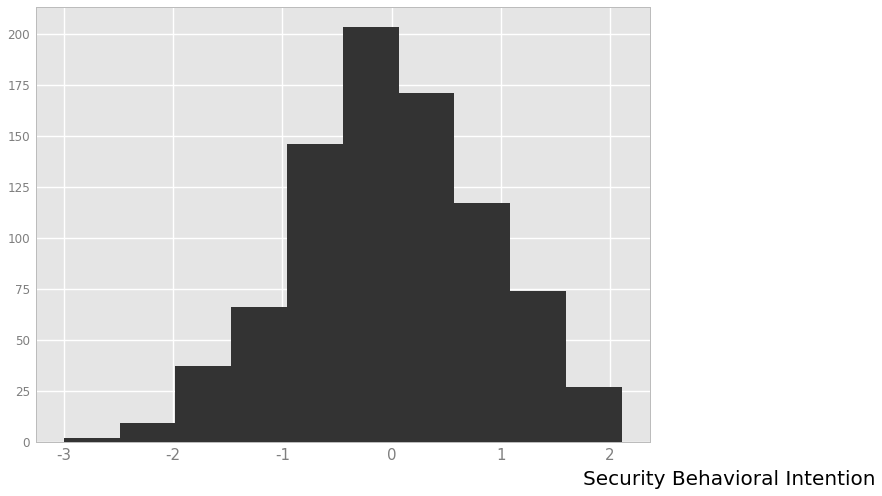

<ggplot: (-9223372029316042580)>

In [37]:
from sklearn.decomposition import FactorAnalysis

sebis_subset = raw_data[sebis_cols]

fa = FactorAnalysis()
fa.n_components = 4
fa_fit = fa.fit(sebis_subset)

# fa_comps = pd.melt(pd.DataFrame(data=fa.fit_transform(sebis_subset)))
fa_comps = fa.fit_transform(sebis_subset)
# print(fa_comps)

biggerFA = FactorAnalysis()
biggerFA.n_components = 1
sbi = biggerFA.fit_transform(fa_comps)*100

# want to calculate explained variance of the factor, taken from https://stackoverflow.com/questions/41388997/factor-analysis-in-sklearn-explained-variance
def calculate_explained_variance(model):
    m = model.components_
    n = model.noise_variance_
    
    m1 = m**2
    m2 = np.sum(m1, axis=1)
    return (100*m2[0]) / (np.sum(m2) + np.sum(n))

print("explained variance of tiered model", calculate_explained_variance(biggerFA))

onefa = FactorAnalysis()
onefa.n_components = 1
onefa_sbi = onefa.fit_transform(sebis_subset)*-1

print("explained variance of smaller model", calculate_explained_variance(onefa))
corrs = [scipy.stats.pearsonr(onefa_sbi, sebis_subset[[col]])[0][0] for col in sebis_cols]
fa_sbi = pd.melt(pd.DataFrame(onefa_sbi))
print(fa_sbi.quantile([0.01, 0.25, 0.5, 0.75, 0.99]))

corrs = [scipy.stats.pearsonr(sbi, sebis_subset[[col]])[0][0] for col in sebis_cols]
print(corrs)

raw_data['sbi'] = onefa_sbi

# weird bug where save renders differently than in notebook
sbi_plot = ggplot(aes(x='value'), data=fa_sbi) +\
    geom_histogram(binwdith=0.01) +\
    xlab("Security Behavioral Intention") +\
    theme(axis_text_x=element_text(size=15),\
          axis_title_x=
              element_text(size=20,\
              text="Security Behavioral Intention",\
              vjust=-0.05\
          ))
sbi_plot.save("out/sbi_histogram.png")
sbi_plot

In [38]:
from sklearn.linear_model import LogisticRegression
from patsy import dmatrices

y, X = dmatrices('did_any ~ sbi', raw_data, return_type="dataframe")

model = LogisticRegression()
model = model.fit(X, y['did_any[True]'])


print(model.score(X, y['did_any[True]']))

0.9471830985915493


In [81]:
# Very basic model modeling whether any behavior change was made to age, gender, SBI and nationality
import statsmodels.api as sm
import statsmodels.formula.api as smf

did_any_map = {
    True: 1,
    False: 0
}


raw_data['did_any_bin'] = raw_data['did_any'].map(did_any_map)
print(raw_data.shape[0])

filtered_srd = raw_data.loc[(raw_data['Nationality'] == "United States") | (raw_data['Nationality'] == "India")]
filtered_srd = filtered_srd.loc[(filtered_srd['Gender'] == "Male") | (filtered_srd["Gender"] == "Female")]
print(filtered_srd.did_any_bin.value_counts())
print(filtered_srd.shape)

sm_model = smf.glm(formula='did_any_bin ~ sbi + Age + Gender + Nationality', data=filtered_srd, family=sm.families.Binomial()).fit()
print(sm_model.summary())

852
1    725
0     44
Name: did_any_bin, dtype: int64
(769, 376)
                 Generalized Linear Model Regression Results                  
Dep. Variable:            did_any_bin   No. Observations:                  769
Model:                            GLM   Df Residuals:                      764
Model Family:                Binomial   Df Model:                            4
Link Function:                  logit   Scale:                             1.0
Method:                          IRLS   Log-Likelihood:                -162.76
Date:                Tue, 04 Sep 2018   Deviance:                       325.52
Time:                        14:58:45   Pearson chi2:                     762.
No. Iterations:                     6                                         
                                   coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------------------
Intercept                     

In [47]:
filtered_srd['uid'] = list(range(0, filtered_srd.shape[0]))
idvars = ['uid', 'sbi', 'Age', 'Gender', 'Nationality']

In [49]:
# Next, gotta create dataset for different behavior triggers. First, gotta add a userid col
trigger_mats = []
for prefix in behavior_prefices:
    valvars = [(prefix + "-" + suffix) for suffix in trigger_suffices]
    trigger_mats.append(pd.melt(filtered_srd, id_vars=idvars, value_vars=valvars).dropna())
    # melt
trigger_mat = pd.concat(trigger_mats)
trigger_mat.index = list(range(0, trigger_mat.shape[0]))
print(trigger_mat.head(1))

trigger_map = {
    'StrangerBreach': 'reactive',
    'KnownBreach': 'social',
    'ShareAccess': 'social',
    'ObservedOthers': 'social',
    'ReceivedAdvice': 'social',
    'DevicePrompt': 'reactive',
    'OrgRequired': 'reactive',
    'ReadNews': 'proactive',
    'BrowsedSetting': 'proactive',
    'OtherTrigger': 'other',
    'NoTrigger': 'proactive' 
}

higher_level_triggers = ['reactive', 'social', 'proactive', 'other']


def higher_level_trigger(val, trigger_type):
    b, t = val.split("-")
    return 1 if trigger_map[t] == trigger_type else 0

def higher_level_trigger_idx(idx, mat, varcol, valcol, trigger_type):
    b, t = mat.loc[idx][varcol].split("-")
    if t == "OtherTriggerClassified":
        return 1 if mat.loc[idx][valcol] == trigger_type else 0
    else:
        return 1 if trigger_map[t] == trigger_type else 0

def extract_behavior(val):
    b, t = val.split("-")
    return b

for hlt in higher_level_triggers:
    # trigger_mat[("trigger_" + hlt)] = trigger_mat['variable'].map(lambda x: higher_level_trigger(x, hlt))
    trigger_mat[("trigger_" + hlt)] = list(map(lambda x: higher_level_trigger_idx(x, trigger_mat, 'variable', 'value', hlt), trigger_mat.index))

# trigger_mat['trigger'] = trigger_mat['variable'].map(lambda x: higher_level_trigger(x, 'social'))
trigger_mat['behavior'] = trigger_mat['variable'].map(extract_behavior)

print("reactive")
print_series_counts(trigger_mat['trigger_reactive'])
print("--")

print("social")
print_series_counts(trigger_mat['trigger_social'])
print("--")

print("proactive")
print_series_counts(trigger_mat['trigger_proactive'])
print("--")

print("other")
print_series_counts(trigger_mat['trigger_other'])
print("--")

print("behavior")
print_series_counts(trigger_mat['behavior'])

/Users/chimps/anaconda3/lib/python3.6/site-packages/pandas/core/reshape/reshape.py:731: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  frame = frame.loc[:, id_vars + value_vars]
/Users/chimps/anaconda3/lib/python3.6/site-packages/pandas/core/indexing.py:1367: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#deprecate-loc-reindex-listlike
  return self._getitem_tuple(key)


   uid       sbi  Age Gender Nationality                   variable  \
0   78 -0.711342   26   Male       India  MobileAuth-StrangerBreach   

                                               value  
0  I directly experienced a security breach from ...  
reactive
   count      rate
0   2181  0.738321
1    773  0.261679

--
social
   count      rate
0   1801  0.609682
1   1153  0.390318

--
proactive
   count      rate
0   1949  0.659783
1   1005  0.340217

--
other
   count  rate
0   2954   1.0

--
behavior
                  count      rate
ChangedPwd          960  0.324983
MobileAuth          869  0.294177
SNSPrivacyChange    783  0.265064
AppUninstall        342  0.115775



In [68]:
tmp = trigger_mat
tmp['bid'] = tmp['uid'].astype(str) + "_" + tmp['behavior']
tmat_expanded = pd.melt(tmp, id_vars=["uid", "bid"], value_vars=["trigger_social", "trigger_proactive", "trigger_reactive"])
print(tmat_expanded.head(5))

   uid             bid        variable  value
0   78   78_MobileAuth  trigger_social      0
1   80   80_MobileAuth  trigger_social      0
2   84   84_MobileAuth  trigger_social      0
3  110  110_MobileAuth  trigger_social      0
4  115  115_MobileAuth  trigger_social      0


In [46]:
from sklearn.preprocessing import scale

trigger_mat['Age'] = scale(trigger_mat['Age'])
# trigger_mat['sbi'] = scale(trigger_mat['sbi'])

ValueError: Found array with 0 sample(s) (shape=(0,)) while a minimum of 1 is required by the scale function.

In [77]:
from rpy2.robjects import r, pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.robjects.lib.ggplot2 as ggplot2

pandas2ri.activate()

lme = importr('lme4')
multcomp = importr('multcomp')

r_trigger_mat = pandas2ri.py2ri(trigger_mat)

r_hlt_models = {}
r_hlt_comps = {}

r_contrast_vec = ro.IntVector([
    0, 0, 0, 0, 0, 1, 0, 0, # ChangedPwd vs AppUninst
    0, 0, 0, 0, 0, 0, 1, 0, # MobileAuth vs AppUninst
    0, 0, 0, 0, 0, 0, 0, 1, # SNSPrivacy vs AppUninst
    0, 0, 0, 0, 0, -1, 1, 0, # MobileAuth vs. ChangedPwd
    0, 0, 0, 0, 0, -1, 0, 1, # SNSPrivacy vs ChangedPwd
    0, 0, 0, 0, 0, 0, -1, 1 # SNSPrivacy vs MobileAuth
])

r_contrast_matrix = r['matrix'](r_contrast_vec, nrow = 6, byrow=True)

for hlt in ['social', 'reactive', 'proactive']:
    dv = "trigger_" + hlt
    r_hlt_models[hlt] = lme.glmer(dv + " ~ sbi + Age + Gender + Nationality + behavior + (1 | uid)", data=r_trigger_mat, family="binomial")
    r_hlt_comps[hlt] = multcomp.glht(r_hlt_models[hlt], r_contrast_matrix)
# can switch DV between trigger_proactive, trigger_social and trigger_reactive
# r_glmer_model = lme.glmer("trigger_proactive ~ sbi + Age + Gender + Nationality + behavior + (1 | uid)", data=r_trigger_mat, family="binomial")
# print(r.head(r_trigger_mat))

 [1]
  0
  0
  0
  0
  0
  1
  0
  0
  0
  0
  0
  0
  0
  0
  1
  0
  0
  0
  0
  0
  0
  0
  0
  1
  0


[26]
  0
  0
  0
  0
 -1
  1
  0
  0
  0
  0
  0
  0
 -1
  0
  1
  0
  0
  0
  0
  0
  0
 -1
  1


 [1]  0  0  0  0  0  1  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  1  0
[26]  0  0  0  0 -1  1  0  0  0  0  0  0 -1  0  1  0  0  0  0  0  0 -1  1



In [79]:
r_tmat_expanded = pandas2ri.py2ri(tmat_expanded)

r_exp_contrast_vec = ro.IntVector([
    0, 1, 0, # reactive vs proactive
    0, 0, 1, # social vs proactive
    0, -1, 1 # reactive vs social
])
r_exp_contrast_matrix = r['matrix'](r_exp_contrast_vec, nrow = 3, byrow=True)

print(r.print(r_exp_contrast_vec))

tmp = lme.glmer("value ~ variable + (1|uid) + (1 | bid)", data=r_tmat_expanded, family="binomial")
print(r.summary(tmp))
tmpcomp = multcomp.glht(tmp, r_exp_contrast_matrix)
print(r.summary(tmpcomp))

[1]
  0
  1
  0
  0
  0
  1
  0
 -1
  1


[1]  0  1  0  0  0  1  0 -1  1

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: value ~ variable + (1 | uid) + (1 | bid)
   Data: structure(list(uid = c(78L, 80L, 84L, 110L, 115L, 137L, 153L,  
162L, 237L, 245L, 342L, 374L, 377L, 383L, 386L, 411L, 417L, 439L,  
463L, 498L, 513L, 530L, 532L, 540L, 563L, 586L, 589L, 597L, 611L,  
620L, 634L, 636L, 656L, 658L, 667L, 669L, 686L, 703L, 708L, 714L,  
722L, 747L, 754L, 768L, 29L, 43L, 58L, 63L, 83L, 86L, 98L, 115L,  
117L, 122L, 123L, 127L, 159L, 175L, 223L, 229L, 237L, 273L, 324L,  
378L, 459L, 463L, 496L, 501L, 513L, 514L, 518L, 541L, 572L, 586L,  
592L, 593L, 603L, 613L, 664L, 670L, 687L, 688L, 695L, 696L, 704L,  
745L, 747L, 753L, 766L, 11L, 15L, 20L, 25L, 27L, 29L, 39L, 42L,  
44L, 45L, 46L, 51L, 53L, 58L, 62L, 63L, 74L, 75L, 76L, 80L, 81L,  
83L, 84L, 96L, 103L, 115L, 117L, 119L, 120L, 127L, 138L, 143L,  
144L, 1


	 Simultaneous Tests for General Linear Hypotheses

Fit: (function (formula, data = NULL, family = gaussian, control = glmerControl(), 
    start = NULL, verbose = 0L, nAGQ = 1L, subset, weights, na.action, 
    offset, contrasts = NULL, mustart, etastart, devFunOnly = FALSE, 
    ...) 
{
    if (!inherits(control, "glmerControl")) {
        if (!is.list(control)) 
            stop("'control' is not a list; use glmerControl()")
        if (class(control)[1] == "lmerControl") {
            warning("please use glmerControl() instead of lmerControl()", 
                immediate. = TRUE)
            control <- c(control[!names(control) %in% c("checkConv", 
                "checkControl")], control$checkControl, control$checkConv)
            control["restart_edge"] <- NULL
        }
        else {
            msg <- "Use control=glmerControl(..) instead of passing a list"
            if (length(cl <- class(control))) {
                msg <- paste(msg, "of class", dQuote(cl[1]))
        

In [41]:
# print(r.scale(r_trigger_mat[2]))
print(r.summary(r_hlt_models['reactive']))

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: trigger_reactive ~ sbi + Age + Gender + Nationality + behavior +  
    (1 | uid)
   Data: structure(list(uid = c(78L, 80L, 84L, 110L, 115L, 137L, 153L,  
162L, 237L, 245L, 342L, 374L, 377L, 383L, 386L, 411L, 417L, 439L,  
463L, 498L, 513L, 530L, 532L, 540L, 563L, 586L, 589L, 597L, 611L,  
620L, 634L, 636L, 656L, 658L, 667L, 669L, 686L, 703L, 708L, 714L,  
722L, 747L, 754L, 768L, 29L, 43L, 58L, 63L, 83L, 86L, 98L, 115L,  
117L, 122L, 123L, 127L, 159L, 175L, 223L, 229L, 237L, 273L, 324L,  
378L, 459L, 463L, 496L, 501L, 513L, 514L, 518L, 541L, 572L, 586L,  
592L, 593L, 603L, 613L, 664L, 670L, 687L, 688L, 695L, 696L, 704L,  
745L, 747L, 753L, 766L, 11L, 15L, 20L, 25L, 27L, 29L, 39L, 42L,  
44L, 45L, 46L, 51L, 53L, 58L, 62L, 63L, 74L, 75L, 76L, 80L, 81L,  
83L, 84L, 96L, 103L, 115L, 117L, 119L, 120L, 127L, 138L, 143L,  
144L, 168L, 170L, 177L, 180L, 201L, 237L,

In [81]:
trigger_mat['social_pred'] = pandas2ri.ri2py(r.predict(r_hlt_models['social']))
trigger_mat['reactive_pred'] = pandas2ri.ri2py(r.predict(r_hlt_models['reactive']))
trigger_mat['proactive_pred'] = pandas2ri.ri2py(r.predict(r_hlt_models['proactive']))
tm_viz = pd.melt(trigger_mat, id_vars=['uid', 'Age', 'Gender', 'Nationality', 'sbi', 'behavior'], value_vars=['social_pred', 'reactive_pred', 'proactive_pred'])
tm_viz.to_csv('./tm_viz.csv')

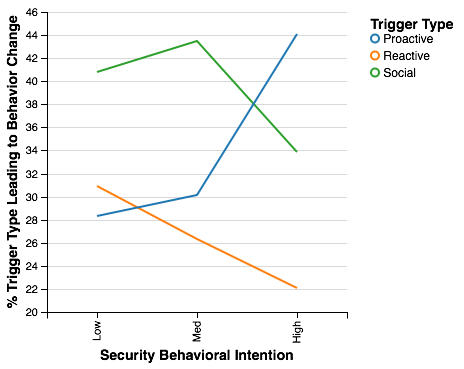

In [69]:
# print((trigger_mat['uid'].astype(str) + "_" + trigger_mat['behavior']).value_counts())
lqt, hqt = trigger_mat['sbi'].quantile([.33, .66])
def split_sbi(val):
    if val <= lqt:
        return 'Low'
    elif val > lqt and val <= hqt:
        return 'Med'
    else:
        return 'High'
trigger_mat['user_sbi_quant'] = trigger_mat['sbi'].map(split_sbi)
tm_sbi_agg = trigger_mat.groupby('user_sbi_quant')[['trigger_social', 'trigger_reactive', 'trigger_proactive']].sum()
tm_sbi_agg_rates = tm_sbi_agg.apply(lambda x: x / np.sum(x) * 100, 1)
tm_sbi_agg_rates['sbi'] = pd.Categorical(
    tm_sbi_agg_rates.index,\
    ordered=True,\
    categories=["Low", "Med", "High"])

tm_sbi_agg_melted = pd.melt(tm_sbi_agg_rates, id_vars=['sbi'])
sbi_sort_map = {
    'Low': 0,
    'Med': 1,
    'High': 2
}

trigger_sort_map = {
    'trigger_social': 'Social',
    'trigger_reactive': 'Reactive',
    'trigger_proactive': 'Proactive'
}

tm_sbi_agg_melted['sbi_sort'] = tm_sbi_agg_melted['sbi'].map(sbi_sort_map)
tm_sbi_agg_melted['Trigger'] = tm_sbi_agg_melted['variable'].map(trigger_sort_map)
tm_sbi_agg_melted = tm_sbi_agg_melted.rename(index=str, columns={'value': '% Triggers'})
# tm_sbi_agg_melted['% Triggers'] = tm_sbi_agg_melted['value']
# print(tm_sbi_agg_melted)

# tm_sbi_agg_melted['sbi'] = pd.Categorical(
#     tm_sbi_agg_melted['sbi'],\
#     ordered=True,\
#     categories=["Low", "Med", "High"])
tm_sbi_agg_melted.to_csv('./tm_sbi_agg_melted.csv')
alt.Chart(tm_sbi_agg_melted, width=300, height=300).mark_line().encode(
    x=alt.X(field='sbi', axis=alt.Axis(title='Security Behavioral Intention'), sort=alt.SortField(field='sbi_sort', op='max', order='ascending')),
    y=alt.Y(field='% Triggers', axis=alt.Axis(title='% Trigger Type Leading to Behavior Change'), scale=alt.Scale(domain=[20, 45])),
    color=alt.Color('Trigger', legend=alt.Legend(title="Trigger Type"))
).configure_axis(
    titleFontSize=14,
    labelFontSize=16
).configure_legend(
    titleFontSize=14,
    labelFontSize=12
)

In [61]:
# Can potentially kill kernel so don't run, but this is an example of how to use R's ggplot
# pp = ggplot2.ggplot(data=r_trigger_mat) + ggplot2.aes_string(x='Age', y='sbi', col='factor(Gender)') + ggplot2.geom_point() + ggplot2.geom_smooth(ggplot2.aes_string(group = 'factor(Gender)'), method = 'lm')
# pp.save("plot2.png")

In [62]:
# Calculate trigger frequency across behaviors

tmsub = trigger_mat[['behavior', 'trigger_social', 'trigger_reactive', 'trigger_proactive', 'trigger_other']]
tmsubgroup = tmsub.groupby('behavior')

print('social')
print(tmsubgroup.trigger_social.agg({'count': np.sum, 'total': lambda x: x.size, 'rate': lambda x: np.sum(x) / x.size}))
print('--')
print('reactive')
print(tmsubgroup.trigger_reactive.agg({'count': np.sum, 'total': lambda x: x.size, 'rate': lambda x: np.sum(x) / x.size}))
print('--')
print('proactive')
print(tmsubgroup.trigger_proactive.agg({'count': np.sum, 'total': lambda x: x.size, 'rate': lambda x: np.sum(x) / x.size}))

social
                  count  total      rate
behavior                                
AppUninstall        131    342  0.383041
ChangedPwd          273    960  0.284375
MobileAuth          375    869  0.431530
SNSPrivacyChange    374    783  0.477650
--
reactive
                  count  total      rate
behavior                                
AppUninstall         66    342  0.192982
ChangedPwd          375    960  0.390625
MobileAuth          179    869  0.205984
SNSPrivacyChange    153    783  0.195402
--
proactive
                  count  total      rate
behavior                                
AppUninstall        122    342  0.356725
ChangedPwd          312    960  0.325000
MobileAuth          315    869  0.362486
SNSPrivacyChange    256    783  0.326948


/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version
  import sys
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version
  # Remove the CWD from sys.path while we load stuff.
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: FutureWarning: using a dict on a Series for aggregation
is deprecated and will be removed in a future version
  del sys.path[0]


In [64]:
# Now need to create sharing matrix
def row_shared_any(row, keys):
    return 0 if row[keys].isnull().all() else 1

sharing_mats = []
sharing_idvars = ['uid', 'sbi', 'Age', 'Gender', 'Nationality', 'social_trigger']
for prefix in behavior_prefices:
    # First, get the behavior col corresponding to this prefix
    bcol = prefix_to_behavior_map[prefix]
    # Subset filtered_srd s.t. only people who've done the behavior remain
    fsrd_subset = filtered_srd.loc[filtered_srd[bcol] == DID_BEHAVIOR_OPT]
    # Enumerate sharing cols for this behavior
    valvars = [(prefix + "-" + suffix) for suffix in shared_suffices]
    # Create new column -- 1 for shared, 0 for not shared
    fsrd_subset['shared'] = fsrd_subset.apply(lambda x: row_shared_any(x, valvars), 1)
    # now have to add the 'social trigger' var
    fsrd_subset['social_trigger'] = fsrd_subset.apply(lambda row: calc_social_or_not(prefix, row), 1).map({ True: 1, False: 0})
    tmp_melted = pd.melt(fsrd_subset, id_vars=sharing_idvars, value_vars=['shared'])
    tmp_melted['behavior'] = prefix
    # Append to sharing_mats list
    sharing_mats.append(tmp_melted)

sharing_mat = pd.concat(sharing_mats)
print(sharing_mat.social_trigger.value_counts())
# print(sharing_mat.groupby('behavior').agg(lambda x: np.sum(x['value'])))
print(sharing_mat.head(5))
sharing_mat.to_csv('./sharing_mat.csv')

/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app
/Users/chimps/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/chimps/anaconda3/lib/python3.6/site-packages/pandas/core/series.py:705: FutureWarning: 
Passing list-likes to .loc or [] with any missing label will raise
KeyError in the future, you can use .reindex() as an alternative.

See the documentation here:
http

0    977
1    775
Name: social_trigger, dtype: int64
   uid       sbi  Age  Gender    Nationality  social_trigger variable  value  \
0    3  0.878659   26  Female          India               0   shared      0   
1    5 -0.151419   29    Male          India               1   shared      0   
2    8 -0.031159   30    Male  United States               0   shared      0   
3    9 -0.521402   25    Male  United States               0   shared      0   
4   11  1.414582   39    Male  United States               1   shared      1   

     behavior  
0  MobileAuth  
1  MobileAuth  
2  MobileAuth  
3  MobileAuth  
4  MobileAuth  


In [323]:
r_sharing_mat = pandas2ri.py2ri(sharing_mat)
r_glmer_sharing_model = lme.glmer("value ~ sbi + Age + Gender + Nationality + social_trigger + behavior + (1 | uid)", data=r_sharing_mat, family="binomial")
r_sharing_contrast_vec = ro.IntVector([
    0, 0, 0, 0, 0, 0, 1, 0, 0,\
    0, 0, 0, 0, 0, 0, 0, 1, 0,\
    0, 0, 0, 0, 0, 0, 0, 0, 1,\
    0, 0, 0, 0, 0, 0, -1, 1, 0,\
    0, 0, 0, 0, 0, 0, -1, 0, 1,\
    0, 0, 0, 0, 0, 0, 0, -1, 1
])
r_sharing_contrast_matrix = r['matrix'](r_sharing_contrast_vec, nrow = 6, byrow=True)
r_glmer_sharing_comp = multcomp.glht(r_glmer_sharing_model, r_sharing_contrast_matrix)
print(r.summary(r_glmer_sharing_comp))


	 Simultaneous Tests for General Linear Hypotheses

Fit: (function (formula, data = NULL, family = gaussian, control = glmerControl(), 
    start = NULL, verbose = 0L, nAGQ = 1L, subset, weights, na.action, 
    offset, contrasts = NULL, mustart, etastart, devFunOnly = FALSE, 
    ...) 
{
    if (!inherits(control, "glmerControl")) {
        if (!is.list(control)) 
            stop("'control' is not a list; use glmerControl()")
        if (class(control)[1] == "lmerControl") {
            warning("please use glmerControl() instead of lmerControl()", 
                immediate. = TRUE)
            control <- c(control[!names(control) %in% c("checkConv", 
                "checkControl")], control$checkControl, control$checkConv)
            control["restart_edge"] <- NULL
        }
        else {
            msg <- "Use control=glmerControl(..) instead of passing a list"
            if (length(cl <- class(control))) {
                msg <- paste(msg, "of class", dQuote(cl[1]))
        

In [324]:
print(r.summary(r_glmer_sharing_model))

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: 
value ~ sbi + Age + Gender + Nationality + social_trigger + behavior +  
    (1 | uid)
   Data: structure(list(uid = c(3L, 5L, 8L, 9L, 11L, 12L, 13L, 15L, 16L,  
17L, 18L, 20L, 22L, 24L, 25L, 27L, 28L, 29L, 32L, 33L, 35L, 36L,  
39L, 40L, 41L, 42L, 43L, 44L, 45L, 46L, 48L, 49L, 50L, 51L, 53L,  
54L, 55L, 56L, 57L, 58L, 59L, 62L, 63L, 66L, 68L, 70L, 71L, 72L,  
74L, 75L, 76L, 78L, 80L, 81L, 82L, 83L, 84L, 85L, 86L, 87L, 88L,  
89L, 96L, 98L, 103L, 104L, 108L, 110L, 114L, 115L, 117L, 118L,  
119L, 120L, 122L, 123L, 124L, 127L, 128L, 129L, 137L, 138L, 140L,  
143L, 144L, 148L, 149L, 151L, 153L, 155L, 159L, 160L, 161L, 162L,  
168L, 169L, 170L, 172L, 173L, 174L, 175L, 176L, 177L, 178L, 180L,  
183L, 187L, 189L, 195L, 197L, 198L, 199L, 201L, 208L, 209L, 210L,  
217L, 220L, 221L, 223L, 226L, 227L, 229L, 230L, 231L, 233L, 234L,  
235L, 237L, 242L, 243L, 244L, 24

### Gonna explore the "other trigger" category to see if we can classify
behavior_other_trigger_cols = [(prefix+"-OtherTrigger2") for prefix in behavior_prefices]

for col in behavior_other_trigger_cols:
    print(social_raw_data.index, social_raw_data[col].dropna().value_counts())
    print("---")

In [502]:
social_raw_data['RecentChangeOpenEnded'].dropna().to_csv("./unlisted-change.csv")

In [88]:
# unnecessary now. Used on tech_usage_subset_2 to annotate 'other' behaviors. Keeping for posterity.
'''
unlisted_password_rows = list(map(lambda x: x - 2, [3, 34, 108, 121, 166, 167, 173, 195, 253, 271, 329, 335, 358, 382, 409, 458, 475, 498, 512, 538, 640, 698, 705, 727, 734, 791]))
unlisted_sns_rows = list(map(lambda x: x - 2, [100, 141, 216, 278, 323, 408, 513, 643, 757]))
unlisted_app_uninstall_rows = list(map(lambda x: x - 2, [513]))

OPEN_ENDED_COL = "RecentChangeOpenEnded"

def get_cols_for_pref(prefix):
    return list(raw_data.filter(like=prefix, axis='columns'))

def change_unlisted_to_behavior(uindices, prefix):
    bcol = prefix_to_behavior_map[prefix]
    rd_sub = raw_data.loc[uindices]
    
    rd_sub[bcol] = DID_BEHAVIOR_OPT
    rd_sub[OPEN_ENDED_COL] = "NaN"
    for col in unlisted_cols:
        col_comps = col.split("-")
        col_comps.pop(0)
        suf = "-".join(col_comps)
        ncol = prefix + "-" + suf
        if ncol in get_cols_for_pref(prefix):
            rd_sub[ncol] = rd_sub[col]
            rd_sub[col] = ""
    raw_data.loc[uindices] = rd_sub
    
unlisted_cols = list(raw_data.filter(like="UnlistedChange", axis='columns'))

# change_unlisted_to_behavior(unlisted_password_rows, 'ChangedPwd')
# change_unlisted_to_behavior(unlisted_sns_rows, 'SNSPrivacyChange')
# change_unlisted_to_behavior(unlisted_app_uninstall_rows, 'AppUninstall')

# print(raw_data.head(5))
raw_data.to_csv("./tech_usage_subset_3.csv")
'''

In [127]:
for prefix in behavior_prefices:
    print(prefix)
    print(raw_data[prefix + "-OtherTrigger2"].value_counts())
    print("--")

MobileAuth
I always make everything as secure as I can-  I got a new phone; so I had to add a passcode to my phone                                                                                              1
My facebook account used in some other country; I don't know how they accessed- So I frequently changed password in everything-                                                                      1
As a routine; I changed authentication-                                                                                                                                                              1
I regularly change my passwords and access methods every two to three months-                                                                                                                        1
I just wanted to try it out-                                                                                                                                                                     